<p style="font-family: helvetica,arial,sans-serif; font-size:1.8em;color:white; background-color: black; height:28px; ">&emsp;<b>Evaluate Business Location Using Pedestrian Traffic: Day and Night</b></p>
    
<p style="font-family: helvetica,arial,sans-serif; font-size:1.6em;color:black; background-color: #DDDDDD; ">&emsp;<b>Authored by: </b>Barkha Javed, Weiren Kong</p>

<p style="font-family: helvetica,arial,sans-serif; font-size:1.6em;color:white; background-color: black; text-align:right">
<b>Duration:</b> 75 mins&emsp;</p>

<p style="font-family: helvetica,arial,sans-serif; font-size:1.6em;color:black; background-color: #DDDDDD;">&emsp;<b>Level:</b> Intermediate&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;<b>Pre-requisite Skills:</b>Python</p>

<p style="font-family: helvetica,arial,sans-serif; font-size:1.6em;color:white; background-color: black">&emsp;<b>Scenario</b>

**As a business owner, I want to know how much pedestrian foot traffic occurs around me during the day and night, so that I can evaluate the suitability of the location and hours for my business.**

Busy foot traffic in a business area may not always mean busy foot traffic at night.

**As a business owner, I want to know how much pedestrian foot traffic I get compared to surrounding areas, so that I can assess if it is better to adapt my hours, extend or move locations.**

* Foot traffic flow during day or night may indicate adapting staff levels during specific hours. 

* Significantly low foot traffic in comparison to other streets may mean adapting business strategy or moving location.

* Duration of steady foot traffic from early morning to mid afternoon only, may indicate adapting business hours to match.



<p style="font-family: helvetica,arial,sans-serif; font-size:1.6em;color:white; background-color: black">&emsp;<b>What this Use Case will teach you</b>

At the end of this use case you will understand how to:

* Load and examine the pedestrian sensor location dataset
* Load and examine the pedestrian counting system - monthly (counts per hour)monthly hourly counts dataset
* Use these datasets to explore day and night foot traffic in an area
* Use visualisations to share results
* Use machine learning to identify if there are any common patterns in day and night traffic


<p style="font-family: helvetica,arial,sans-serif; font-size:1.6em;color:white; background-color: black">&emsp;<b>A brief introduction to the datasets used</b>

Briefly about each dataset and intended use 

* 


The exploratory data analysis on day and night showing initial findings is available, please refer to [compare pedestrian traffic day night]( https://github.com/Chameleon-company/MOP-Code/blob/barkhaj-branch/datascience/dataanalysis/Other%20EDA/eda_compare_pedestrian_traffic_day_night.ipynb)

<p style="font-family: helvetica,arial,sans-serif; font-size:1.6em;color:white; background-color: black">&emsp;<b>Accessing and Loading data</b>

In [1]:
#Libraries to be installed
##!pip -q is to give less output
!pip -q install sodapy
!pip -q install seaborn
!pip -q install pandas
!pip -q install matplotlib
!pip -q install numpy
!pip -q install nbconvert
!pip -q install keyboard
!pip -q install geopandas
!pip -q install sklearn
!pip -q install folium

In [2]:
#load libraries
import os
import time
import keyboard

from datetime import datetime
import numpy as np
import pandas as pd
from sodapy import Socrata
import seaborn as sns

from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA

import matplotlib.pyplot as plt
%matplotlib inline
from matplotlib import style
style.use('ggplot')

import plotly.graph_objs as go
import plotly.express as px

import warnings
warnings.filterwarnings('ignore')

import folium
from folium.plugins import MarkerCluster

#Socrata client connection
client = Socrata('data.melbourne.vic.gov.au', '9UAGAvkem9fqXDhBLElapjazL', None)


#### Load Pedestrian sensor location data

In [3]:
#Pedestrian sensor location data
sensor_data_id = "h57g-5234"
results = client.get(sensor_data_id)
sensor_location = pd.DataFrame.from_records(results)
#sensor_location.head(5)

sensor_location[['latitude', 'longitude']] = sensor_location[['latitude', 'longitude']].astype(float)
sensor_location = sensor_location.drop('location',axis=1)
sensor_location['lat'] = sensor_location['latitude'].apply(lambda x: float(x))
sensor_location['lon'] = sensor_location['longitude'].apply(lambda x: float(x))

#View sensor data
sensor_location.info()
sensor_location.head(5)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 91 entries, 0 to 90
Data columns (total 12 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   sensor_id           91 non-null     object 
 1   sensor_description  91 non-null     object 
 2   sensor_name         91 non-null     object 
 3   installation_date   91 non-null     object 
 4   status              91 non-null     object 
 5   note                10 non-null     object 
 6   latitude            91 non-null     float64
 7   longitude           91 non-null     float64
 8   direction_1         78 non-null     object 
 9   direction_2         78 non-null     object 
 10  lat                 91 non-null     float64
 11  lon                 91 non-null     float64
dtypes: float64(4), object(8)
memory usage: 8.7+ KB


,sensor_id,sensor_description,sensor_name,installation_date,status,note,latitude,longitude,direction_1,direction_2,lat,lon
0,16,Australia on Collins,Col270_T,2009-03-30T00:00:00.000,R,Device moved to location ID 53 (22/09/2015),-37.815734,144.965210,NaN,NaN,-37.815734,144.965210
1,50,Faraday St-Lygon St (West),Lyg309_T,2017-11-30T00:00:00.000,A,NaN,-37.798082,144.967210,South,North,-37.798082,144.967210
2,73,Bourke St - Spencer St (South),Bou655_T,2020-10-02T00:00:00.000,I,NaN,-37.816957,144.954154,East,West,-37.816957,144.954154
3,66,State Library - New,QVN_T,2020-04-06T00:00:00.000,A,NaN,-37.810578,144.964443,South,North,-37.810578,144.964443
4,59,Building 80 RMIT,RMIT_T,2019-02-13T00:00:00.000,A,NaN,-37.808256,144.963049,South,North,-37.808256,144.963049


#### Load Pedestrian monthly hourly count data

In [5]:
#Pedestrian foot count data 
#Uncomment the below to open data source, download sensor data, and store it as a csv locally.
sensor_data_id = "b2ak-trbp"
# results = client.get(sensor_data_id, limit=7000000)
# ds_traffic = pd.DataFrame.from_records(results)
# ds_traffic.to_csv('sensor_traffic.csv', index=False)

sensor_traffic = pd.read_csv('sensor_traffic.csv')
sensor_traffic.info()

print(f'\nThe shape of dataset is {sensor_traffic.shape}. \n')
print('Below are the first few rows of this dataset: ')
sensor_traffic.head(10)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4463670 entries, 0 to 4463669
Data columns (total 10 columns):
 #   Column         Dtype 
---  ------         ----- 
 0   id             int64 
 1   date_time      object
 2   year           int64 
 3   month          object
 4   mdate          int64 
 5   day            object
 6   time           int64 
 7   sensor_id      int64 
 8   sensor_name    object
 9   hourly_counts  int64 
dtypes: int64(6), object(4)
memory usage: 340.6+ MB

The shape of dataset is (4463670, 10). 

Below are the first few rows of this dataset: 


,id,date_time,year,month,mdate,day,time,sensor_id,sensor_name,hourly_counts
0,2887628,2019-11-01T17:00:00.000,2019,November,1,Friday,17,34,Flinders St-Spark La,300
1,2887629,2019-11-01T17:00:00.000,2019,November,1,Friday,17,39,Alfred Place,604
2,2887630,2019-11-01T17:00:00.000,2019,November,1,Friday,17,37,Lygon St (East),216
3,2887631,2019-11-01T17:00:00.000,2019,November,1,Friday,17,40,Lonsdale St-Spring St (West),627
4,2887632,2019-11-01T17:00:00.000,2019,November,1,Friday,17,36,Queen St (West),774
5,2887633,2019-11-01T17:00:00.000,2019,November,1,Friday,17,29,St Kilda Rd-Alexandra Gardens,644
6,2887634,2019-11-01T17:00:00.000,2019,November,1,Friday,17,42,Grattan St-Swanston St (West),453
7,2887635,2019-11-01T17:00:00.000,2019,November,1,Friday,17,43,Monash Rd-Swanston St (West),387
8,2887636,2019-11-01T17:00:00.000,2019,November,1,Friday,17,44,Tin Alley-Swanston St (West),27
9,2887637,2019-11-01T17:00:00.000,2019,November,1,Friday,17,35,Southbank,2691


#### Merge Pedestrian sensor location and traffic data

In [6]:
#Add date column
sensor_traffic['date'] = pd.to_datetime(sensor_traffic.date_time).dt.date

#Add day of week column
sensor_traffic['dow'] = pd.to_datetime(sensor_traffic.date_time).dt.day_of_week

#convert sensor_id to integer
sensor_traffic['sensor_id']=sensor_traffic['sensor_id'].astype(int)
sensor_location['sensor_id']=sensor_location['sensor_id'].astype(int)

# Mesh pedestrian sensor location and foot traffic datasets
sensor_ds = pd.merge(sensor_traffic, sensor_location, on='sensor_id')

#Simply using the year to differentiate all the years prior to 2020 as before Covid, and post 2019 Covid traffic to now
sensor_ds['pre2020_hourly_counts'] = np.where(sensor_ds['year']<2020,sensor_ds['hourly_counts'] , 0)
sensor_ds['post2019_hourly_counts'] = np.where(sensor_ds['year']>2019,sensor_ds['hourly_counts'] , 0)

#Add column for day or night traffic
#Add column for day (5am to 5pm) or night (6pm to 4am) traffic
sensor_ds['day_counts']   = np.where(((sensor_ds['time']>4)  & (sensor_ds['time']<18)),sensor_ds['hourly_counts'] , 0)
sensor_ds['night_counts'] = np.where(sensor_ds['day_counts']==0,sensor_ds['hourly_counts'], 0)

sensor_ds.describe()


,id,year,mdate,time,sensor_id,hourly_counts,dow,latitude,longitude,lat,lon,pre2020_hourly_counts,post2019_hourly_counts,day_counts,night_counts
count,4.463670e+06,4.463670e+06,4.463670e+06,4.463670e+06,4.463670e+06,4.463670e+06,4.463670e+06,4.463670e+06,4.463670e+06,4.463670e+06,4.463670e+06,4.463670e+06,4.463670e+06,4.463670e+06,4.463670e+06
mean,2.232320e+06,2.017230e+03,1.574741e+01,1.146917e+01,2.700226e+01,4.951352e+02,2.999995e+00,-3.781345e+01,1.449621e+02,-3.781345e+01,1.449621e+02,4.074119e+02,8.772332e+01,3.594659e+02,1.356693e+02
std,1.289316e+06,3.551188e+00,8.800020e+00,6.938594e+00,1.951539e+01,7.509822e+02,2.000015e+00,6.187582e-03,8.531568e-03,6.187582e-03,8.531568e-03,7.443612e+02,2.852713e+02,7.131327e+02,3.910920e+02
min,1.000000e+00,2.009000e+03,1.000000e+00,0.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,-3.782402e+01,1.449297e+02,-3.782402e+01,1.449297e+02,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,1.115918e+06,2.015000e+03,8.000000e+00,5.000000e+00,1.100000e+01,4.300000e+01,1.000000e+00,-3.781874e+01,1.449587e+02,-3.781874e+01,1.449587e+02,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
50%,2.231836e+06,2.018000e+03,1.600000e+01,1.100000e+01,2.300000e+01,1.780000e+02,3.000000e+00,-3.781381e+01,1.449651e+02,-3.781381e+01,1.449651e+02,6.200000e+01,0.000000e+00,2.400000e+01,0.000000e+00
75%,3.347753e+06,2.020000e+03,2.300000e+01,1.700000e+01,4.100000e+01,6.050000e+02,5.000000e+00,-3.781102e+01,1.449669e+02,-3.781102e+01,1.449669e+02,4.530000e+02,2.400000e+01,3.520000e+02,5.900000e+01
max,4.469141e+06,2.022000e+03,3.100000e+01,2.300000e+01,8.700000e+01,1.597900e+04,6.000000e+00,-3.779432e+01,1.449747e+02,-3.779432e+01,1.449747e+02,1.597900e+04,1.443700e+04,1.161200e+04,1.597900e+04


### Separate day and night data sets

In [34]:
flag_value=0
df_day=sensor_ds.query("day_counts > @flag_value")
print('Day info\n', df_day.info(),'\n')

df_night=sensor_ds.query("day_counts == @flag_value")
print('Night info \n',df_night.info(),'\n')


<class 'pandas.core.frame.DataFrame'>
Int64Index: 2402520 entries, 0 to 4463663
Data columns (total 27 columns):
 #   Column                  Dtype  
---  ------                  -----  
 0   id                      int64  
 1   date_time               object 
 2   year                    int64  
 3   month                   object 
 4   mdate                   int64  
 5   day                     object 
 6   time                    int64  
 7   sensor_id               int32  
 8   sensor_name_x           object 
 9   hourly_counts           int64  
 10  date                    object 
 11  dow                     int64  
 12  sensor_description      object 
 13  sensor_name_y           object 
 14  installation_date       object 
 15  status                  object 
 16  note                    object 
 17  latitude                float64
 18  longitude               float64
 19  direction_1             object 
 20  direction_2             object 
 21  lat                     float64

Separate day and night, and before and after Covid for mapping

In [13]:
#split dataset to map difference between time before covid-19 and time after covid-19
df = df_day
#print(df_day.head(2))

df_daypft_beforecovid = df.loc[df['year']<2020]
df_daypft_aftercovid = df.loc[df['year']>2019]

#get average hourly count for each sensor during the selected period of time
df_daypft_beforecovid_avg = df_daypft_beforecovid[['sensor_id','sensor_description','lat','lon','hourly_counts']]
df_daypft_beforecovid_avg = df_daypft_beforecovid_avg.groupby(['sensor_id','sensor_description','lat','lon',],as_index=False).agg({'hourly_counts': 'mean'})
df_daypft_aftercovid_avg = df_daypft_aftercovid[['sensor_id','sensor_description','lat','lon','hourly_counts']]
df_daypft_aftercovid_avg = df_daypft_aftercovid_avg.groupby(['sensor_id','sensor_description','lat','lon',],as_index=False).agg({'hourly_counts': 'mean'})

<p style="font-family: helvetica,arial,sans-serif; font-size:1.6em;color:white; background-color: black">&emsp;<b>Examine Pedestrian Traffic</b>

Pedestrian traffic has decreased after 2019, the aim is to try to understand patterns of day and night traffic.

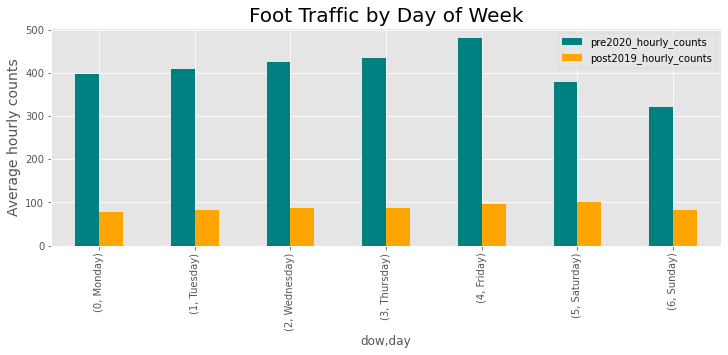

In [9]:
#examine pre Covid and post 2019 foot traffic
ds = pd.DataFrame(sensor_ds.groupby(["dow","day"])["pre2020_hourly_counts","post2019_hourly_counts"].mean())
df = ds.sort_values(by=['dow'])
axs = df.plot.bar(figsize=(12, 4), color=["teal","orange"])
axs.set_title('Foot Traffic by Day of Week', size=20)
axs.set_ylabel('Average hourly counts', size=14)
plt.show()


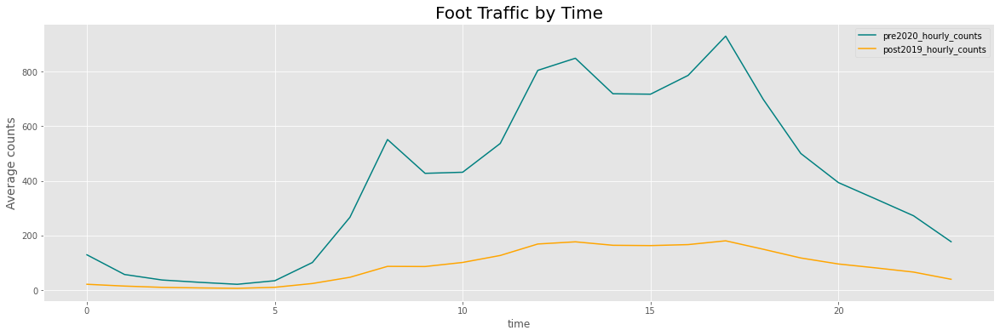

In [10]:
#examine pre Covid and post 2019 foot traffic
ds = pd.DataFrame(sensor_ds.groupby(["time"])["pre2020_hourly_counts","post2019_hourly_counts"].mean())
df = ds.sort_values(by=['time'])
axs = df.plot.line(figsize=(20, 6), color=["teal","orange"])
axs.set_title('Foot Traffic by Time', size=20)
axs.set_ylabel('Average counts', size=14)
plt.show()


Examine, if day and night traffic vary by location

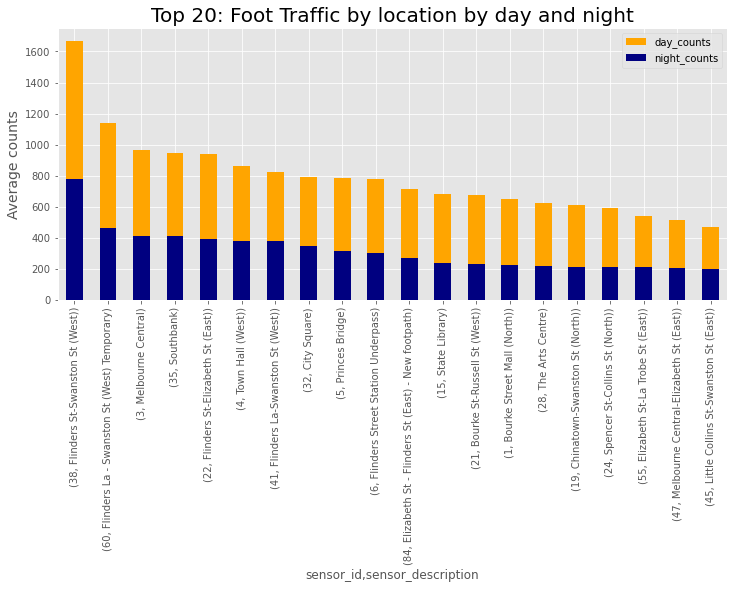

In [11]:
#distribution by traffic, by day
pivot = pd.pivot_table(sensor_ds, values='day_counts', index=['sensor_id','sensor_description'], aggfunc=np.mean)
pivot_ds = pivot['day_counts'].nlargest(n=20)
pivot_ds.plot.bar(figsize=(12, 5), color='orange', legend=True);

#by night
pivot = pd.pivot_table(sensor_ds, values='night_counts', index=['sensor_id','sensor_description'], aggfunc=np.mean)
pivot_ds = pivot['night_counts'].nlargest(n=20)
axs = pivot_ds.plot.bar(figsize=(12, 5), color='navy', legend=True);

axs.set_title('Top 20: Foot Traffic by location by day and night', size=20)
axs.set_ylabel('Average counts', size=14)
plt.show()

<p style="font-family: helvetica,arial,sans-serif; font-size:1.6em;color:white; background-color: black">&emsp;<b>Day Economy</b>
    
We can see changes in the traffic of each sensor before Covid and after Covid on the map below. Please right click on the icon in the top right corner of the map and select the layer to see traffic before Covid.

### Compare day traffic before Covid and now on a map

In [15]:
#Visualise day data
m = folium.Map(location=[-37.8167, 144.967], zoom_start=15) # tiles='Stamen Toner'
locations = []
for i in range(len(df_daypft_beforecovid_avg)):
    row =df_daypft_beforecovid_avg.iloc[i]
    location = [(row.lat,row.lon)]*int(row['hourly_counts'])
    locations += location
marker_cluster  = MarkerCluster(
  name='day traffic before covid-19',
  locations=locations,
  overlay=True,
  control=True,
  color='cyan',
  show=False # this removes from automatic selection in display - need to select to show data points
  )
marker_cluster.add_to(m)
locations = []
for i in range(len(df_daypft_aftercovid_avg)):
    row =df_daypft_aftercovid_avg.iloc[i]
    location = [(row.lat,row.lon)]*int(row['hourly_counts'])
    locations += location
marker_cluster  = MarkerCluster(
  name='day traffic after covid-19',
  locations=locations,
  overlay=True,
  control=True,
  ) 
marker_cluster.add_to(m)
folium.LayerControl().add_to(m)
m

### Clustering: Day Traffic

Discover if any patterns in day traffic

In [16]:
#identify class and features
use_list = ["sensor_id","time", "dow","hourly_counts","lat","lon"]
loc_day = pd.DataFrame(df_day[use_list])
print(loc_day.head(5))

codes = loc_day[['sensor_id']] #class
loc_day.drop('sensor_id', axis=1, inplace=True)
loc_day.head(5)

    sensor_id  time  dow  hourly_counts       lat         lon
0          34    17    4            300 -37.81538  144.974151
12         34     5    5              7 -37.81538  144.974151
13         34     6    5             16 -37.81538  144.974151
14         34     7    5             37 -37.81538  144.974151
15         34     8    5             36 -37.81538  144.974151


,time,dow,hourly_counts,lat,lon
0,17,4,300,-37.81538,144.974151
12,5,5,7,-37.81538,144.974151
13,6,5,16,-37.81538,144.974151
14,7,5,37,-37.81538,144.974151
15,8,5,36,-37.81538,144.974151


In [17]:
#examine data
loc_day.describe()

,time,dow,hourly_counts,lat,lon
count,2.402520e+06,2.402520e+06,2.402520e+06,2.402520e+06,2.402520e+06
mean,1.101223e+01,2.998409e+00,6.678559e+02,-3.781345e+01,1.449621e+02
std,3.736374e+00,1.999525e+00,8.595908e+02,6.182429e-03,8.520379e-03
min,5.000000e+00,0.000000e+00,1.000000e+00,-3.782402e+01,1.449297e+02
25%,8.000000e+00,1.000000e+00,1.050000e+02,-3.781874e+01,1.449587e+02
50%,1.100000e+01,3.000000e+00,3.040000e+02,-3.781381e+01,1.449651e+02
75%,1.400000e+01,5.000000e+00,8.810000e+02,-3.781102e+01,1.449669e+02
max,1.700000e+01,6.000000e+00,1.161200e+04,-3.779432e+01,1.449747e+02


Refer to the EDA on [Compare Pedestrian Traffic Day and Night](https://github.com/Chameleon-company/MOP-Code/blob/barkhaj-branch/datascience/dataanalysis/Other%20EDA/eda_compare_pedestrian_traffic_day_night.ipynb) for details around why specific criteria were chosen

In [19]:
# run k-means clustering, define centroids
kmeans = KMeans(n_clusters=4, random_state=0).fit(loc_day)
centroids = kmeans.cluster_centers_

codes['cluster'] = kmeans.labels_
#codes.head()

In [20]:
#Method from (Carlini: 2019)
pca = PCA().fit(loc_day)
pca_types = pca.transform(loc_day)
print("Variance explained by each component (%): ")
for i in range(len(pca.explained_variance_ratio_)):
      print("\n",i+1,"º:", pca.explained_variance_ratio_[i]*100)
print("Total sum (%): ",sum(pca.explained_variance_ratio_)*100)
print("Explained variance of the first two components (time and dy of week) (%): ",sum(pca.explained_variance_ratio_[0:1])*100)

Variance explained by each component (%): 

 1 º: 99.99781333512182

 2 º: 0.001647938845037798

 3 º: 0.0005387115302386684

 4 º: 9.880694335281589e-09

 5 º: 4.6222075484340015e-09
Total sum (%):  100.0
Explained variance of the first two components (time and dy of week) (%):  99.99781333512182


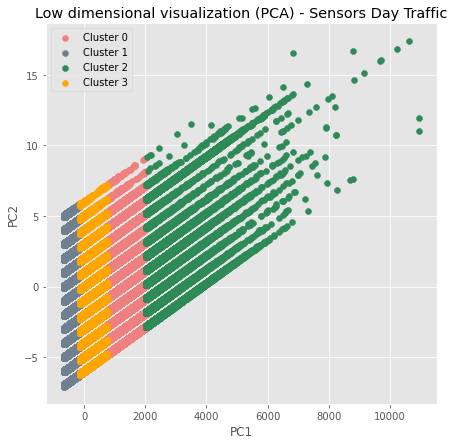

In [21]:
#Code adapted from (Carlini: 2019)
# 4 clusters
c0 = []
c1 = []
c2 = []
c3 = []

for i in range(len(pca_types)):
    if kmeans.labels_[i] == 0:
        c0.append(pca_types[i])
    if kmeans.labels_[i] == 1:
        c1.append(pca_types[i])
    if kmeans.labels_[i] == 2:
        c2.append(pca_types[i])
    if kmeans.labels_[i] == 3:
        c3.append(pca_types[i])
        
        
c0 = np.array(c0)
c1 = np.array(c1)
c2 = np.array(c2)
c3 = np.array(c3)

plt.figure(figsize=(7,7))
plt.scatter(c0[:,0], c0[:,1], c='lightcoral', label='Cluster 0')
plt.scatter(c1[:,0], c1[:,1], c='slategrey', label='Cluster 1')
plt.scatter(c2[:,0], c2[:,1], c='seagreen', label='Cluster 2')
plt.scatter(c3[:,0], c3[:,1], c='orange', label='Cluster 3')
plt.legend()
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.title('Low dimensional visualization (PCA) - Sensors Day Traffic');

    time  dow  hourly_counts       lat         lon  cluster
0     17    4            300 -37.81538  144.974151        1
12     5    5              7 -37.81538  144.974151        1
13     6    5             16 -37.81538  144.974151        1
14     7    5             37 -37.81538  144.974151        1
15     8    5             36 -37.81538  144.974151        1


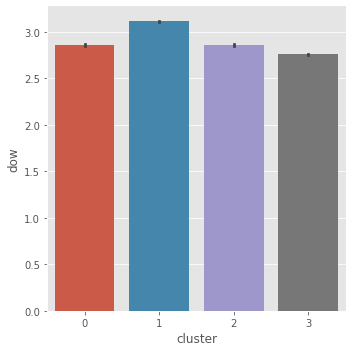

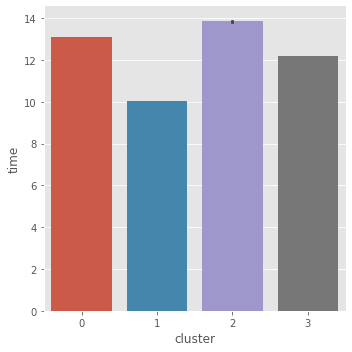

In [22]:
#Code adapted from (Carlini: 2019)
#Add cluster values by sensor, to the data set to see which cluster the sensor belongs to

loc_day['cluster']  = kmeans.labels_
print(loc_day.head(5))

sns.catplot(x='cluster', y='dow', data=loc_day, kind='bar');
sns.catplot(x='cluster', y='time', data=loc_day, kind='bar');

Next steps for this component, we can add in additional factors impacting seasonal traffic, to improve cluster detection.

In [ ]:
#Visualise day data
m = folium.Map(location=[-37.8167, 144.967], zoom_start=15) # tiles='Stamen Toner'
locations = []
for i in range(len(df_daypft_beforecovid_avg)):
    row =df_daypft_beforecovid_avg.iloc[i]
    location = [(row.lat,row.lon)]*int(row['hourly_counts'])
    locations += location
marker_cluster  = MarkerCluster(
  name='day traffic before covid-19',
  locations=locations,
  overlay=True,
  control=True,
  color='cyan',
  show=False # this removes from automatic selection in display - need to select to show data points
  )
marker_cluster.add_to(m)
locations = []
for i in range(len(df_daypft_aftercovid_avg)):
    row =df_daypft_aftercovid_avg.iloc[i]
    location = [(row.lat,row.lon)]*int(row['hourly_counts'])
    locations += location
marker_cluster  = MarkerCluster(
  name='day traffic after covid-19',
  locations=locations,
  overlay=True,
  control=True,
  ) 
marker_cluster.add_to(m)
folium.LayerControl().add_to(m)

<p style="font-family: helvetica,arial,sans-serif; font-size:1.6em;color:white; background-color: black">&emsp;<b>Night Economy</b>

In [29]:
#split dataset to see difference between time before covid-19 and time after covid-19
df = df_night
print(df.head(2))

df_night_beforecovid = df.loc[df['year']<2020]
df_night_aftercovid = df.loc[df['year']>2019]

#get average hourly count for each sensor during the selected period of time
df_night_beforecovid_avg = df_night_beforecovid[['sensor_id','sensor_description','lat','lon','pre2020_hourly_counts']]
df_night_beforecovid_avg = df_night_beforecovid_avg.groupby(['sensor_id','sensor_description','lat','lon',],as_index=False).agg({'pre2020_hourly_counts': 'mean'})
df_night_aftercovid_avg = df_night_aftercovid[['sensor_id','sensor_description','lat','lon','post2019_hourly_counts']]
df_night_aftercovid_avg = df_night_aftercovid_avg.groupby(['sensor_id','sensor_description','lat','lon',],as_index=False).agg({'post2019_hourly_counts': 'mean'})

        id                date_time  year     month  mdate     day  time  \
1  2887683  2019-11-01T18:00:00.000  2019  November      1  Friday    18   
2  2887738  2019-11-01T19:00:00.000  2019  November      1  Friday    19   

   sensor_id         sensor_name_x  hourly_counts  ...  latitude   longitude  \
1         34  Flinders St-Spark La            240  ... -37.81538  144.974151   
2         34  Flinders St-Spark La            158  ... -37.81538  144.974151   

  direction_1 direction_2       lat         lon pre2020_hourly_counts  \
1        East        West -37.81538  144.974151                   240   
2        East        West -37.81538  144.974151                   158   

   post2019_hourly_counts  day_counts night_counts  
1                       0           0          240  
2                       0           0          158  

[2 rows x 27 columns]


### Compare night traffic before Covid and now

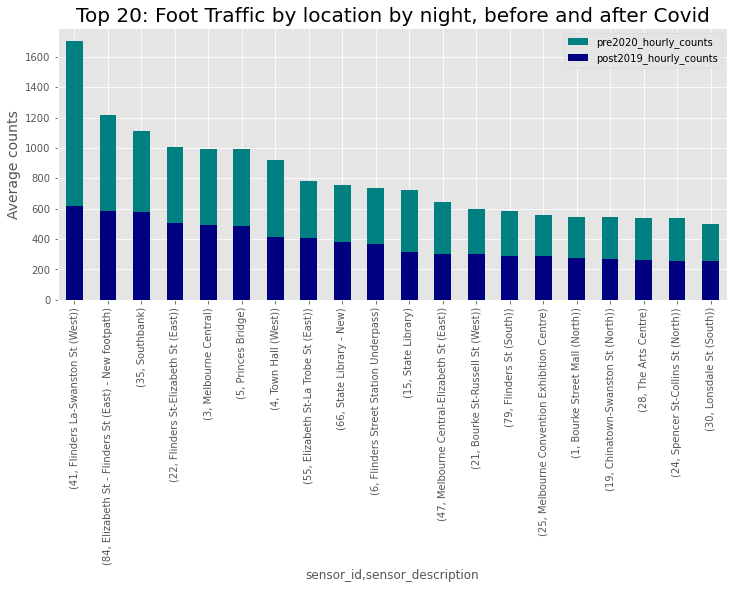

In [30]:
#distribution by traffic
#by night before covid
pivot = pd.pivot_table(df_night_beforecovid, values='pre2020_hourly_counts', index=['sensor_id','sensor_description'], aggfunc=np.mean)
pivot_ds = pivot['pre2020_hourly_counts'].nlargest(n=20)
pivot_ds.plot.bar(figsize=(12, 5), color='teal', legend=True);

#by night after Covid
pivot = pd.pivot_table(df_night_aftercovid, values='post2019_hourly_counts', index=['sensor_id','sensor_description'], aggfunc=np.mean)
pivot_ds = pivot['post2019_hourly_counts'].nlargest(n=20)
axs = pivot_ds.plot.bar(figsize=(12, 5), color='navy', legend=True);

axs.set_title('Top 20: Foot Traffic by location by night, before and after Covid', size=20)
axs.set_ylabel('Average counts', size=14)
plt.show()

In [31]:
#Visualise night data
m = folium.Map(location=[-37.8167, 144.967], zoom_start=15)
locations = []
for i in range(len(df_night_beforecovid_avg)):
    row =df_night_beforecovid_avg.iloc[i]
    location = [(row.lat,row.lon)]*int(row['pre2020_hourly_counts'])
    locations += location
marker_cluster  = MarkerCluster(
  name='Night traffic before Covid-19',
  locations=locations,
  overlay=True,
  control=True,
  show=False # this removes from automatic selection in display - need to select to show data points
  )
marker_cluster.add_to(m)
locations = []
for i in range(len(df_night_aftercovid_avg)):
    row =df_night_aftercovid_avg.iloc[i]
    location = [(row.lat,row.lon)]*int(row['post2019_hourly_counts'])
    locations += location
marker_cluster  = MarkerCluster(
  name='Night traffic after Covid-19',
  locations=locations,
  overlay=True,
  control=True,
  ) 
marker_cluster.add_to(m)
folium.LayerControl().add_to(m)
m

### Clustering: Night Traffic

Discover if any patterns in day traffic

In [37]:
#identify class and features
use_list = ["sensor_id","time", "dow","hourly_counts","lat","lon"]
loc_night = pd.DataFrame(df_night[use_list])
print(loc_night.head(5))

codes = loc_night[['sensor_id']] #class
loc_night.drop('sensor_id', axis=1, inplace=True)
loc_night.head(5)

   sensor_id  time  dow  hourly_counts       lat         lon
1         34    18    4            240 -37.81538  144.974151
2         34    19    4            158 -37.81538  144.974151
3         34    20    4            118 -37.81538  144.974151
4         34    21    4            131 -37.81538  144.974151
5         34    22    4            218 -37.81538  144.974151


,time,dow,hourly_counts,lat,lon
1,18,4,240,-37.81538,144.974151
2,19,4,158,-37.81538,144.974151
3,20,4,118,-37.81538,144.974151
4,21,4,131,-37.81538,144.974151
5,22,4,218,-37.81538,144.974151


In [38]:
#examine data
loc_night.describe()

,time,dow,hourly_counts,lat,lon
count,2.061150e+06,2.061150e+06,2.061150e+06,2.061150e+06,2.061150e+06
mean,1.200180e+01,3.001843e+00,2.938083e+02,-3.781344e+01,1.449621e+02
std,9.352121e+00,2.000586e+00,5.336438e+02,6.193573e-03,8.544569e-03
min,0.000000e+00,0.000000e+00,0.000000e+00,-3.782402e+01,1.449297e+02
25%,2.000000e+00,1.000000e+00,1.600000e+01,-3.781874e+01,1.449587e+02
50%,1.800000e+01,3.000000e+00,7.500000e+01,-3.781381e+01,1.449651e+02
75%,2.100000e+01,5.000000e+00,3.080000e+02,-3.781102e+01,1.449669e+02
max,2.300000e+01,6.000000e+00,1.597900e+04,-3.779432e+01,1.449747e+02


Refer to the EDA on [Compare Pedestrian Traffic Day and Night](https://github.com/Chameleon-company/MOP-Code/blob/barkhaj-branch/datascience/dataanalysis/Other%20EDA/eda_compare_pedestrian_traffic_day_night.ipynb) for details around why specific criteria were chosen

In [39]:
# run k-means clustering, define centroids
kmeans = KMeans(n_clusters=4, random_state=0).fit(loc_night)
centroids = kmeans.cluster_centers_

codes['cluster'] = kmeans.labels_
#codes.head()

In [40]:
#Method from (Carlini: 2019)
pca = PCA().fit(loc_night)
pca_types = pca.transform(loc_night)
print("Variance explained by each component (%): ")
for i in range(len(pca.explained_variance_ratio_)):
      print("\n",i+1,"º:", pca.explained_variance_ratio_[i]*100)
print("Total sum (%): ",sum(pca.explained_variance_ratio_)*100)
print("Explained variance of the first two components (time and dy of week) (%): ",sum(pca.explained_variance_ratio_[0:1])*100)

Variance explained by each component (%): 

 1 º: 99.97152973022305

 2 º: 0.027071823765019622

 3 º: 0.0013984076935646631

 4 º: 2.5677393768627966e-08

 5 º: 1.2640962527016586e-08
Total sum (%):  100.0
Explained variance of the first two components (time and dy of week) (%):  99.97152973022305


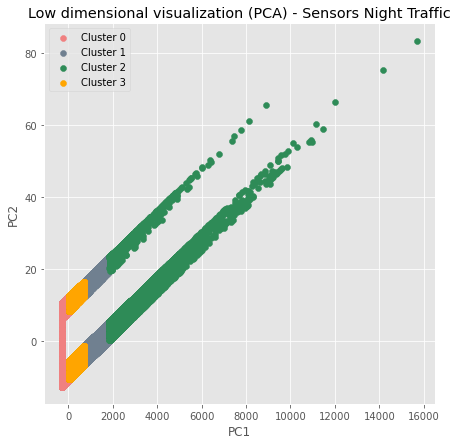

In [41]:
#Code adapted from (Carlini: 2019)
# 4 clusters
c0 = []
c1 = []
c2 = []
c3 = []

for i in range(len(pca_types)):
    if kmeans.labels_[i] == 0:
        c0.append(pca_types[i])
    if kmeans.labels_[i] == 1:
        c1.append(pca_types[i])
    if kmeans.labels_[i] == 2:
        c2.append(pca_types[i])
    if kmeans.labels_[i] == 3:
        c3.append(pca_types[i])
        
        
c0 = np.array(c0)
c1 = np.array(c1)
c2 = np.array(c2)
c3 = np.array(c3)

plt.figure(figsize=(7,7))
plt.scatter(c0[:,0], c0[:,1], c='lightcoral', label='Cluster 0')
plt.scatter(c1[:,0], c1[:,1], c='slategrey', label='Cluster 1')
plt.scatter(c2[:,0], c2[:,1], c='seagreen', label='Cluster 2')
plt.scatter(c3[:,0], c3[:,1], c='orange', label='Cluster 3')
plt.legend()
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.title('Low dimensional visualization (PCA) - Sensors Night Traffic');

   time  dow  hourly_counts       lat         lon  cluster
1    18    4            240 -37.81538  144.974151        0
2    19    4            158 -37.81538  144.974151        0
3    20    4            118 -37.81538  144.974151        0
4    21    4            131 -37.81538  144.974151        0
5    22    4            218 -37.81538  144.974151        0


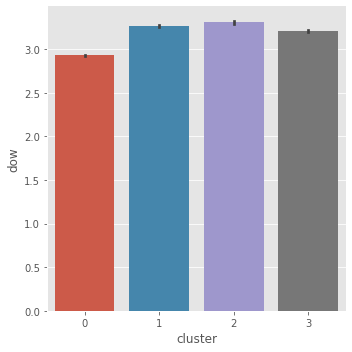

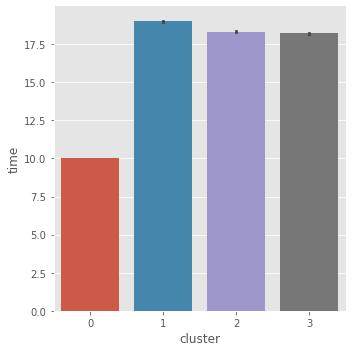

In [42]:
#Code adapted from (Carlini: 2019)
#Add cluster values by sensor, to the data set to see which cluster the sensor belongs to

loc_night['cluster']  = kmeans.labels_
print(loc_night.head(5))

sns.catplot(x='cluster', y='dow', data=loc_night, kind='bar');
sns.catplot(x='cluster', y='time', data=loc_night, kind='bar');

Next steps for this component, we can add in additional factors impacting seasonal traffic, to improve cluster detection.

<p style="font-family: helvetica,arial,sans-serif; font-size:1.6em;color:black; background-color: #EEEEEE">&emsp;<b>Congratulations!</b>

You've successfully used Melbourne Open Data to visualise day and night pedestrian traffic in and around the City of Melbourne!<br>

<p style="font-family: helvetica,arial,sans-serif; font-size:1.6em;color:white; background-color: black">&emsp;<b>References</b>

City of Melbourne Open Data Team, 2014 - 2021,'Pedestrian Counting System - Monthly (counts per hour)', City of Melbourne, date retrieved 11 Aug 2022, <https://dev.socrata.com/foundry/data.melbourne.vic.gov.au/b2ak-trbp>

City of Melbourne Open Data Team, 2014 - 2021,'Pedestrian Counting System - Sensor Locations', City of Melbourne, date retrieved 26 Aug 2022, <https://data.melbourne.vic.gov.au/Transport/Pedestrian-Counting-System-Sensor-Locations/h57g-5234>

Carlini L 2019, 'Clustering and Visualisation using Folium Maps', Kaggle, retrieved 23 Sep 2022 https://www.kaggle.com/code/lucaspcarlini/clustering-and-visualisation-using-folium-maps/notebook#Folium-Maps-Visualisation-by-Number-of-Occurences-and-Clustering

In [43]:
#save notebook, required so that step to convert to html, writes latest results to file
# may need to adapt for other OS, this is for Windows
keyboard.press_and_release('ctrl+s')

!jupyter nbconvert  evaluate_business_location_using_pedestrian_traffic_day_night.ipynb --to html

[NbConvertApp] Converting notebook evaluate_business_location_using_pedestrian_traffic_day_night.ipynb to html
[NbConvertApp] WARNING | Non-unique cell id '2f08af6c' detected. Corrected to 'aded751f'.
[NbConvertApp] WARNING | Non-unique cell id '7edcab5a' detected. Corrected to '20aeca40'.
[NbConvertApp] WARNING | Non-unique cell id '2a8525ed' detected. Corrected to 'a4c8cde0'.
[NbConvertApp] WARNING | Non-unique cell id '8af63da9' detected. Corrected to '71f53e20'.
[NbConvertApp] WARNING | Non-unique cell id '31a09ac1' detected. Corrected to '22e75689'.
[NbConvertApp] WARNING | Non-unique cell id '7c9770ad' detected. Corrected to 'c31bf3e1'.
[NbConvertApp] WARNING | Non-unique cell id '3e8a8031' detected. Corrected to 'dff19f6a'.
[NbConvertApp] WARNING | Non-unique cell id 'c19b16f3' detected. Corrected to '00cd2ff1'.
[NbConvertApp] WARNING | Non-unique cell id '1817689e' detected. Corrected to '4e18925e'.
[NbConvertApp] Writing 25742422 bytes to evaluate_business_location_using_pedes